In [31]:
from PIL import Image
import pandas as pd
import numpy as np
import json
import os
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import umap.umap_ as umap

In [32]:
path = '/mnt/win_share/MLW/'

f = open(os.path.join(path, 'data.json'))
data_tmp = json.load(f)
f.close()
data = pd.DataFrame(data_tmp)

In [33]:
data_id = np.asarray(data['id'])
np.random.shuffle(data_id)
files = list(map(lambda e: str(e) + '.jpg', np.random.choice(data_id, 114)))

In [34]:
images = []
path_images = os.path.join(path, 'zettel')
for file in files:
    images.append(Image.open(os.path.join(path_images, file), mode="r"))

# Processing

In [35]:
images_np = list(map(lambda e: np.array(e), images))

In [36]:
dims = list(map(lambda e: e.shape, images_np))
size_height, size_width = tuple(map(lambda e: min(e), [list(t) for t in zip(*dims)][0:2]))
size_height, size_width

(1177, 1676)

In [37]:
images_cropped = list(map(lambda e: e[0:size_height, 0:size_width], images_np))

In [38]:
images_flattened = list(map(lambda e: e.flatten(), images_cropped))

In [39]:
X = np.stack(images_flattened)

# T-SNE and Visualization

In [40]:
X_embedded = umap.UMAP().fit_transform(X)

In [41]:
x, y = tuple(np.transpose(X_embedded))
data_after = pd.DataFrame({"x" : x, "y" : y})

## Visualization

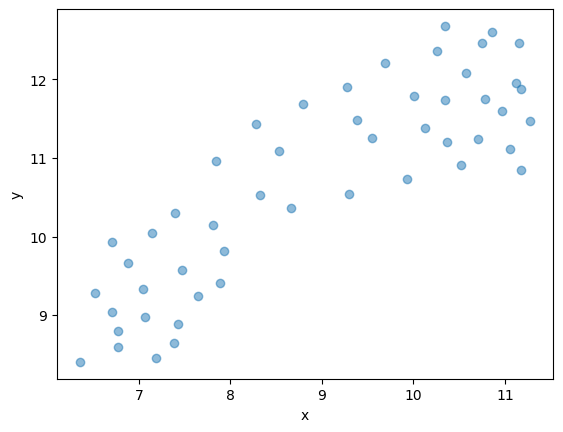

In [42]:
plt.scatter(x, y, alpha=0.5)
plt.xlabel("x")
plt.ylabel("y")
plt.show()

## Analysis of Clusters

In [47]:
slice1 = data_after[(data_after['y'] < 10.5) & (data_after['x'] <= 8.25)]
slice2 = data_after[(data_after['y'] >= 10.5) & (data_after['x'] > 8.25)]

In [48]:
def visualize_example_from_arr(sample):
    i = np.random.choice(range(len(sample)))
    example = sample[i]
    img_arr = np.reshape(example, (size_height, size_width, 3))
    return Image.fromarray(img_arr)

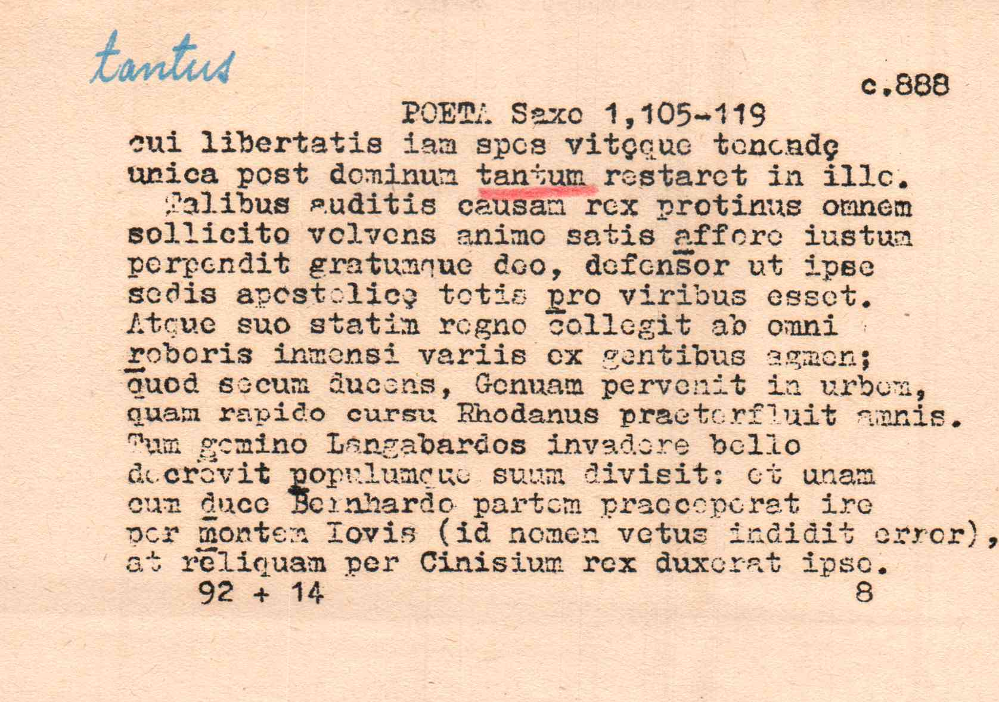

In [49]:
sample = X[slice2.index]
visualize_example_from_arr(sample)

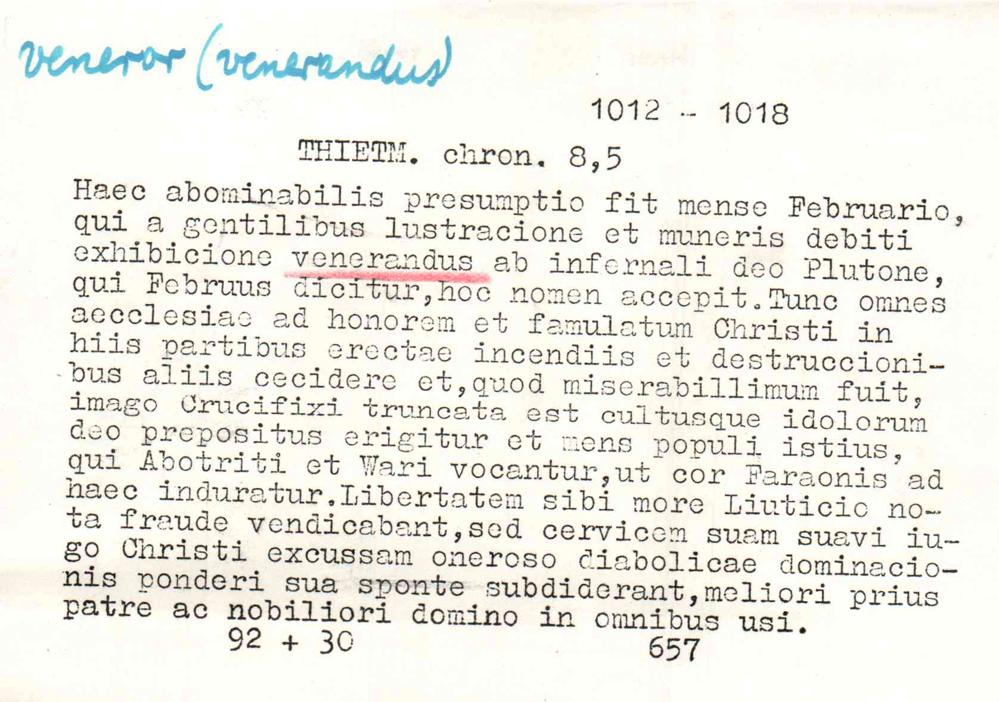

In [50]:
sample = X[slice1.index]
visualize_example_from_arr(sample)

In [51]:
def vis_cluster_sample(data, slice, size_height, size_width, columns = 4, rows = 5, w = 40, h = 40):
    
    fig = plt.figure(figsize=(w, h))
    sample = data[slice.index]
    if len(sample) < columns * rows:
        X = sample
    else:
        indices = np.random.choice(range(len(sample)), columns * rows)
        X = sample[indices]
    for index, i in enumerate(X):
        img_arr = np.reshape(i, (size_height, size_width, 3))
        img = Image.fromarray(img_arr)
        fig.add_subplot(rows, columns, index + 1)
        plt.imshow(img)
    plt.show()

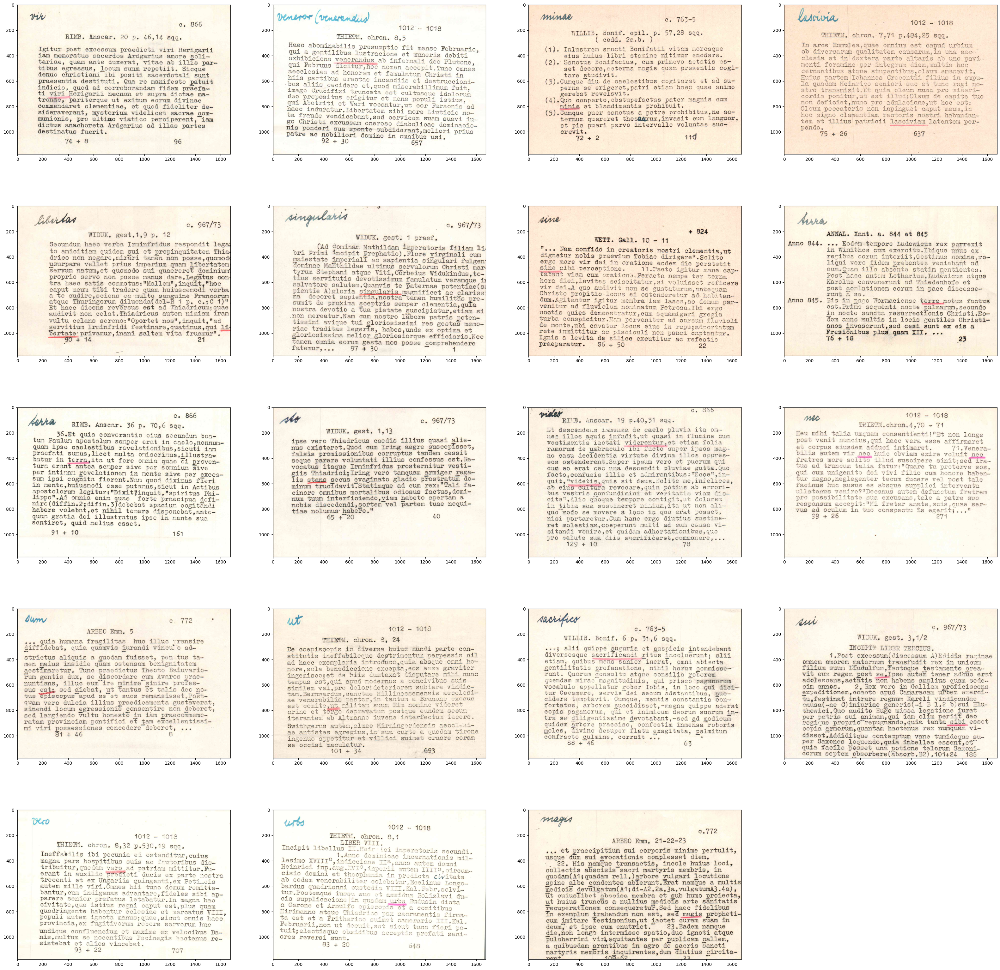

In [52]:
vis_cluster_sample(X, slice1, size_height, size_width)

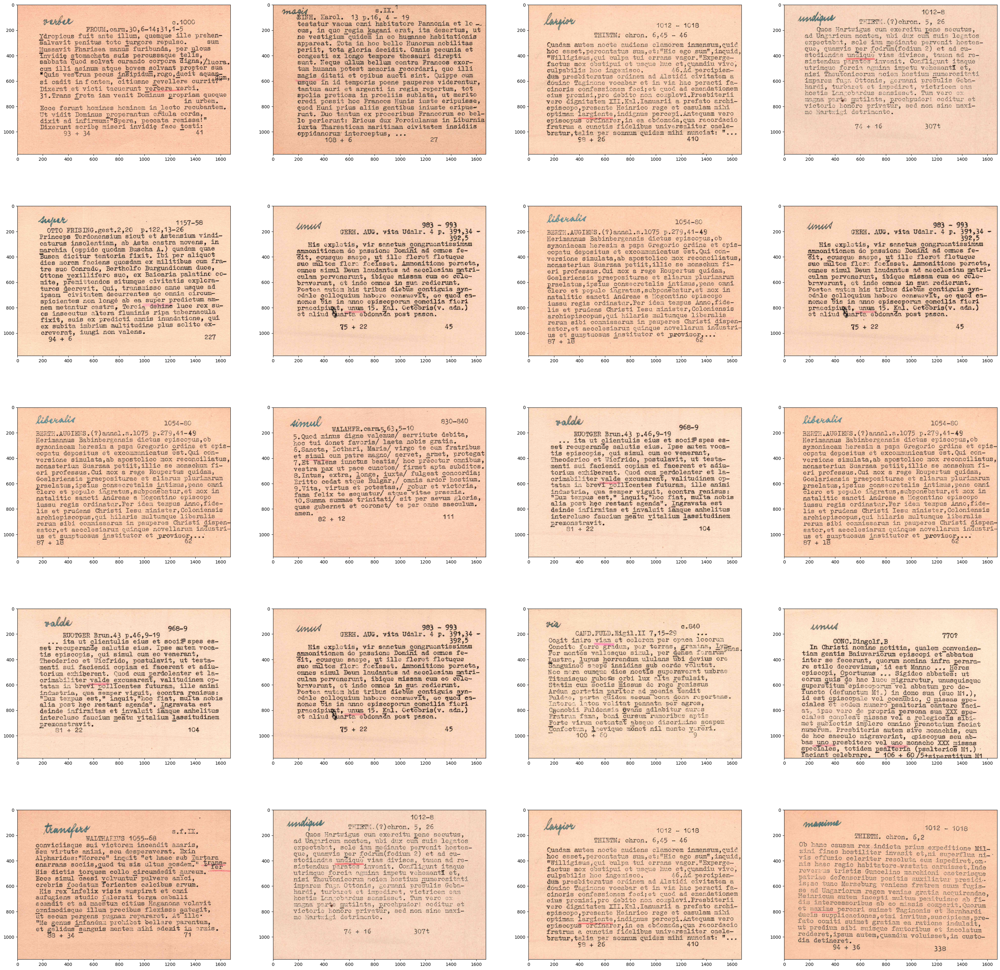

In [53]:
vis_cluster_sample(X, slice2, size_height, size_width)

# Observation
- Akin to T-SNE observation
- Cluster include less variety of colors (sepia vs white images)
- Cluster are organized on a spectrum (possibly from white to sepia)